In [1]:
import warnings
warnings.filterwarnings('ignore')
import os
import numpy as np
import scanpy as sc
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import time

# Evaluation metrics
from sklearn.metrics import (homogeneity_score,v_measure_score,adjusted_mutual_info_score,normalized_mutual_info_score,adjusted_rand_score,fowlkes_mallows_score)

# Import SpaLP modules    Python package: https://github.com/dbjzs/SpaLP
from SpaLP.LP import SpatialLocalPooling
from SpaLP.utils import set_seed, prepare_inputs
# Set random seed
set_seed(7)

#Check the GPU memory and CPU memory
import memory_profiler  # pip install memory_profiler
import torch
import gc

# Check device
import cpuinfo   # pip install py-cpuinfo
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")
if device.type == 'cuda':
    print(f"GPU: {torch.cuda.get_device_name(0)}")
info = cpuinfo.get_cpu_info()
print("CPU:", info['brand_raw'])

Using device: cuda
GPU: NVIDIA A800-SXM4-80GB
CPU: Intel(R) Xeon(R) Platinum 8462Y+


In [2]:
#Check the GPU memory and CPU memory
from memory_profiler import memory_usage
def measure_resources(func):
    def wrapper(*args, **kwargs):
        gc.collect()
        torch.cuda.synchronize()
        torch.cuda.reset_peak_memory_stats()
        torch.cuda.empty_cache()
        
        before = memory_usage(-1, interval=0.1, timeout=1)[0]
        mem_peak, result = memory_usage((func, args, kwargs),max_usage=True,retval=True)
        print(f"CPU peak memory: {(mem_peak - before)/1024:.2f} GB")
        
        torch.cuda.synchronize()
        gpu_peak = torch.cuda.max_memory_allocated() / 1024**3
        print(f"GPU peak memory: {gpu_peak:.2f} GB")
        return result
    return wrapper

In [3]:
def train_spalp(graphs, in_channels, hidden_dim, epochs, lr, device,seed):
    """Train SpaLP model and return embeddings."""
    from tqdm.auto import tqdm
    set_seed(seed)
    pbar = tqdm(range(epochs), desc="Training",ncols=200)
    model = SpatialLocalPooling(in_channels, hidden_dim).to(device)
    
    optimizer = optim.Adam(model.parameters(), lr=lr)
    criterion = nn.MSELoss()
    model.train()
    losses = []
    for epoch in pbar:
        model.train()
        total_loss = 0
        num_batches = 0
        for graph in graphs:
            features = graph.features.to(device)
            neighbor_index = graph.neighbor_idx.to(device)
            optimizer.zero_grad()
            reconstructed, embedding = model(features, neighbor_index)
            loss = criterion(reconstructed, features)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
            num_batches += 1  
        avg_loss = total_loss / num_batches
        losses.append(avg_loss)
        pbar.set_postfix({"Epoch": epoch,"Avg Loss": f"{avg_loss:.4f}"})
    
    # Get final embeddings
    model.eval()
    all_recon = []
    all_emb = []
    with torch.no_grad():
        for graph in graphs:
            features = graph.features.to(device)
            neighbor_index = graph.neighbor_idx.to(device)
            reconstructed, embedding = model(features, neighbor_index)
            all_emb.append(embedding.cpu())
            
    full_emb = torch.cat(all_emb, dim=0)
    
    embedding=full_emb.detach().cpu().numpy()
    return embedding, losses

# 8.4Million mouse brain (MERFISH)
#### • <span style="color:black; font-weight:bold;">Download</span>: 8.4 Million MERFISH Mouse Brain Atlas data used in the tutorial are available at [MERFISH_animal1.h5ad](https://drive.google.com/file/d/193Igb0H7purVCTSBYjMuhSqUlJ6lHAnQ/view?usp=drive_link) , [MERFISH_animal2.h5ad](https://drive.google.com/open?id=1xTO8Wgs1_6eNeXeQF_3TMgUghrASvdS1&usp=drive_fs) , [MERFISH_animal3_sagittal.h5ad](https://drive.google.com/file/d/19djKdcK8MI-p0fC0fj_G81LK6tUNzlye/view?usp=drive_link) and [MERFISH_animal4.h5ad](https://drive.google.com/open?id=1KW5HgTE3zthYJZ5SnhIBV1LOyiYUN8xv&usp=drive_fs)
The availability has been confirmed

In [4]:
# Load 8.4Million mouse brain
import anndata as ad
adata1=sc.read_h5ad('/home/dbj/SpaLA/Batch/MERFISH/MERFISH_animal1.h5ad')
adata2=sc.read_h5ad('/home/dbj/SpaLA/Batch/MERFISH/MERFISH_animal2.h5ad')
adata3=sc.read_h5ad('/home/dbj/SpaLA/Batch/MERFISH/MERFISH_animal3_sagittal.h5ad')
adata4=sc.read_h5ad('/home/dbj/SpaLA/Batch/MERFISH/MERFISH_animal4.h5ad')

adata1.var_names=adata1.var['gene_name']
adata2.var_names=adata2.var['gene_name']
adata3.var_names=adata3.var['gene_name']
adata4.var_names=adata4.var['gene_name']

adata_list=[adata1,adata2,adata3,adata4]
adata = ad.concat(adata_list, join="inner")

adata.obs['batch']=adata.obs['donor_id']
adata.obs['slice']=adata.obs['brain_section_label']
adata.obsm['spatial']=adata.obsm['X_spatial_coords']

In [5]:
# Preprocessing standardization  *******
start_time = time.time()
adatas = []
for batch in adata.obs['batch'].unique():  #Preprocess each batch independently and then merge them.
    a = adata[adata.obs['batch'] == batch].copy()
    sc.pp.normalize_total(a, inplace=True)
    sc.pp.log1p(a)
    sc.pp.scale(a)
    adatas.append(a)
adata = ad.concat(adatas, join="inner")
adata.obsm['feat']=adata.X
prep_time = time.time() - start_time

print(f"Spatial coords shape: {adata.obsm['spatial'].shape}")
print(f"Preprocessing standardization: {prep_time:.2f}s")

Spatial coords shape: (8380288, 2)
Preprocessing standardization: 102.48s


In [6]:
# Set the hyperparameters  k=9
k=9
in_channels = adata.obsm['feat'].shape[1]
lr=0.001
epochs = 20
hidden_dim=32
print(f"Feature dimensions: {in_channels}")

Feature dimensions: 1122


In [7]:
%%time
#Iterate input each slice after shuffling the slice order
import random
adata_list = [adata[adata.obs['slice'] == s] for s in adata.obs['slice'].unique()]
random.shuffle(adata_list)
del adata

CPU times: user 6.6 s, sys: 1.35 s, total: 7.94 s
Wall time: 7.95 s


In [8]:
# Build neighbor graph  k=10
from SpaLP.utils import Graph
start_time = time.time()
#compute a separate spatial neighbor index matrix for each sample
graphs = []
for adata in adata_list:
    graph = prepare_inputs(adata, k=10,device='cpu')#The data is placed in the cpu to prevent GPU memory overflow
    graphs.append(graph)

prep_time = time.time() - start_time
print(f"Graph preparation: {prep_time:.2f}s")

Graph preparation: 26.99s


In [9]:
import anndata as ad
adata=ad.concat(adata_list)

In [10]:
%%time
#runtime /GPU peak memory/CPU peak memory
start_time = time.time()
@measure_resources
def run_train():
    return train_spalp(graphs, in_channels, hidden_dim, epochs, lr, device, seed=7)#The default random seed for the SpaLP algorithm is 7.
embedding, losses = run_train()
train_time = time.time() - start_time
print(f"Training time: {train_time:.2f}s")

# Store embeddings
adata.obsm['SpaLP'] = embedding

Training: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [02:09<00:00,  6.49s/it, Epoch=19, Avg Loss=0.9322]


CPU peak memory: 2.38 GB
GPU peak memory: 4.74 GB
Training time: 137.58s
CPU times: user 2min 9s, sys: 11.5 s, total: 2min 21s
Wall time: 2min 17s


In [20]:
%%time
# KMeans time
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=30, random_state=2024) 
labels = kmeans.fit_predict(adata.obsm['SpaLP'])
adata.obs['Kmeans_SpaLP']=labels.astype(str)  #The clustering results save in adata.obs['Kmeans_SpaLP']

CPU times: user 9min 3s, sys: 18min 44s, total: 27min 48s
Wall time: 30.3 s


In [12]:
adata.write_h5ad('/home/dbj/SpaLP/gittest/repoduced/result/Fig58-4Million.h5ad',compression='gzip')  #Save the embedding for rapid single-cell (GPU-scanpy) analysis.

# Kmeans_result

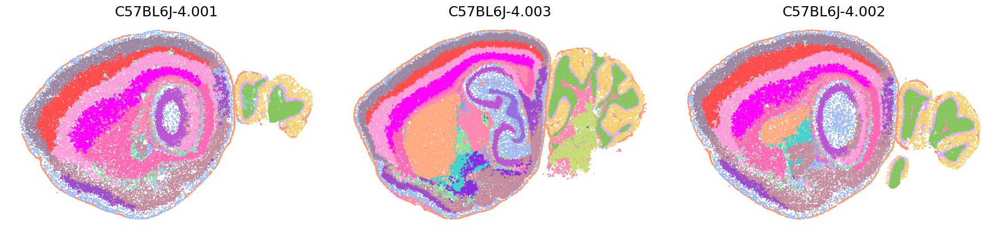

In [31]:
## batch4
from SpaLP.utils import create_new_color_dict
latent_cluster_colors = create_new_color_dict(adata=adata,cat_key='Kmeans_SpaLP',skip_default_colors=1)
adata_batch4=adata[adata.obs['batch']=='C57BL6J-4']
samples = adata_batch4.obs['slice'].unique().tolist()
import matplotlib.pyplot as plt
import scanpy as sc
plt.rcParams['figure.figsize'] = (20, 20)
plt.rcParams['font.size'] = 15

samples = adata_batch4.obs['slice'].unique().tolist()

num_rows = 6  
num_cols = min(len(samples), 3)  

fig, axs = plt.subplots(num_rows, num_cols, figsize=(6 * num_cols, 4 * num_rows))
axs = axs.flatten()

for idx, sample in enumerate(samples):
    sc.pl.embedding(adata=adata_batch4[adata_batch4.obs['slice'] == sample], basis='spatial', color=['Kmeans_SpaLP'],title=sample, legend_loc=None, frameon=False, ax=axs[idx], show=False, palette=latent_cluster_colors, size=13, ncols=7)

for idx in range(len(samples), len(axs)):
    fig.delaxes(axs[idx])

plt.tight_layout()  
plt.show()

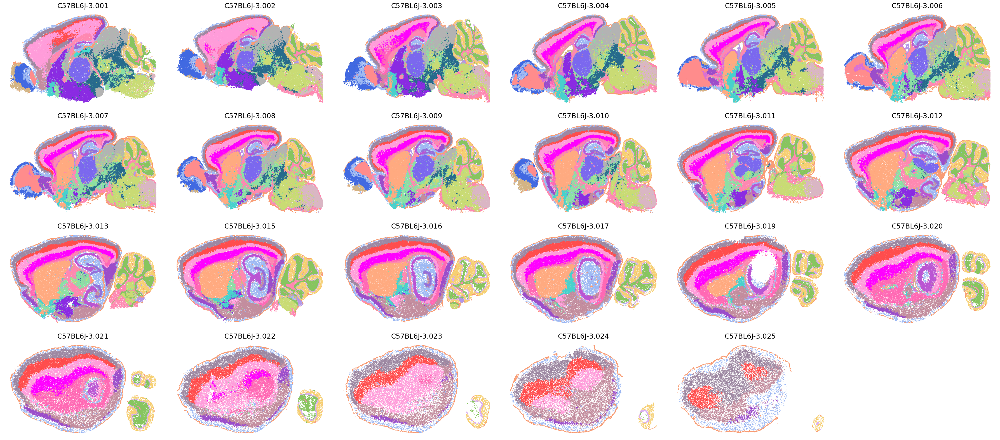

In [32]:
##batch3
adata_batch3=adata[adata.obs['batch']=='C57BL6J-3']
import re
samples = adata_batch3.obs['slice'].unique().tolist()

def sort_key(s):
    nums = re.findall(r'\d+', str(s))
    return int(nums[-1]) if nums else float('inf')

samples = sorted(samples, key=sort_key)
import matplotlib.pyplot as plt
import scanpy as sc
plt.rcParams['figure.figsize'] = (20, 20)
plt.rcParams['font.size'] = 15

num_cols = 6
num_rows = (len(samples) + num_cols - 1) // num_cols  

fig, axs = plt.subplots(num_rows, num_cols, figsize=(6 * num_cols, 4 * num_rows))
axs = axs.flatten()

for idx, sample in enumerate(samples):
    if idx < len(axs):  
        sc.pl.embedding(adata=adata_batch3[adata_batch3.obs['slice'] == sample], basis='spatial', color=['Kmeans_SpaLP'],title=sample, legend_loc=None, frameon=False, ax=axs[idx], show=False, palette=latent_cluster_colors, size=13, ncols=7)

for idx in range(len(samples), len(axs)):
    fig.delaxes(axs[idx])

plt.tight_layout()  
plt.show()

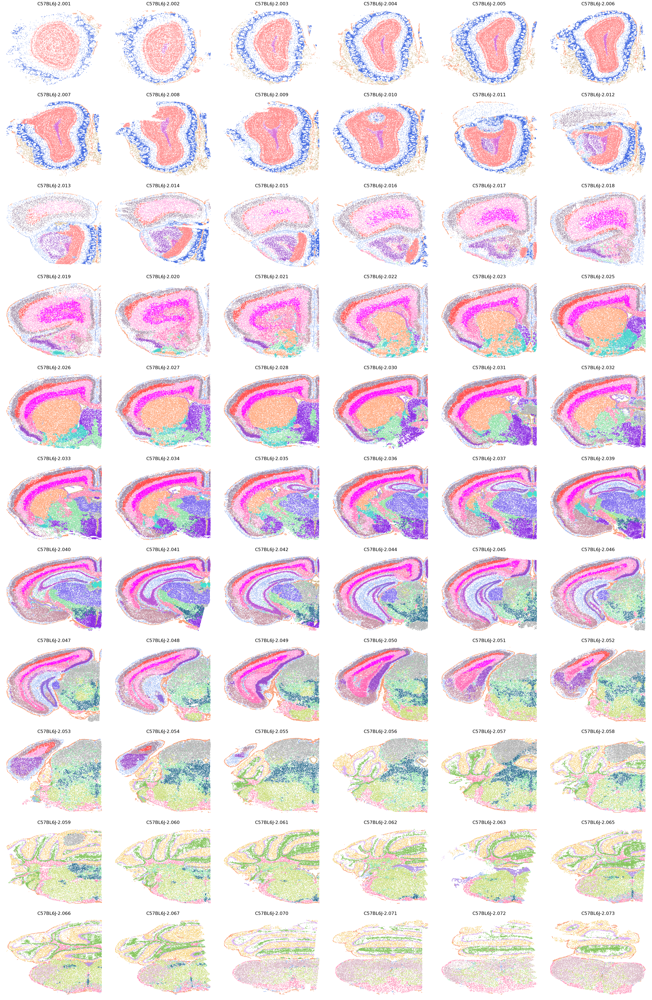

In [33]:
##batch2
adata_batch2=adata[adata.obs['batch']=='C57BL6J-2']
import re
samples = adata_batch2.obs['slice'].unique().tolist()

def sort_key(s):
    nums = re.findall(r'\d+', str(s))
    return int(nums[-1]) if nums else float('inf')

samples = sorted(samples, key=sort_key)
import matplotlib.pyplot as plt
import scanpy as sc
plt.rcParams['figure.figsize'] = (18, 18)
plt.rcParams['font.size'] = 15


num_cols = 6
num_rows = (len(samples) + num_cols - 1) // num_cols  

fig, axs = plt.subplots(num_rows, num_cols, figsize=(6 * num_cols, 5 * num_rows))
axs = axs.flatten()

for idx, sample in enumerate(samples):
    if idx < len(axs):  
        sc.pl.embedding(adata=adata_batch2[adata_batch2.obs['slice'] == sample], basis='spatial', color=['Kmeans_SpaLP'],title=sample, legend_loc=None, frameon=False, ax=axs[idx], show=False, palette=latent_cluster_colors, size=13, ncols=7)

for idx in range(len(samples), len(axs)):
    fig.delaxes(axs[idx])

plt.tight_layout()  
plt.show()

In [ ]:
##batch1
adata_batch1=adata[adata.obs['batch']=='C57BL6J-1']
import re
samples = adata_batch1.obs['slice'].unique().tolist()

def sort_key(s):
    nums = re.findall(r'\d+', str(s))
    return int(nums[-1]) if nums else float('inf')

samples = sorted(samples, key=sort_key)
import matplotlib.pyplot as plt
import scanpy as sc
plt.rcParams['figure.figsize'] = (20, 20)
plt.rcParams['font.size'] = 15


num_cols = 6
num_rows = (len(samples) + num_cols - 1) // num_cols  

fig, axs = plt.subplots(num_rows, num_cols, figsize=(6 * num_cols, 5 * num_rows))
axs = axs.flatten()

for idx, sample in enumerate(samples):
    if idx < len(axs):  
        sc.pl.embedding(adata=adata_batch1[adata_batch1.obs['slice'] == sample], basis='spatial', color=['Kmeans_SpaLP'],title=sample, legend_loc=None, frameon=False, ax=axs[idx], show=False, palette=latent_cluster_colors, size=12, ncols=7)

for idx in range(len(samples), len(axs)):
    fig.delaxes(axs[idx])

plt.tight_layout()  
plt.show()